In [1]:
import numpy as np
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import plotly.io as pio
import plotly.express as px
import shapely.geometry
import wget
pio.renderers.default = "notebook"

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
gdf = gpd.read_file('./data/SeattleGISData/Seattle_Streets.geojson')

In [4]:
gdf.columns

Index(['OBJECTID', 'ARTCLASS', 'COMPKEY', 'UNITID', 'UNITID2', 'UNITIDSORT',
       'UNITDESC', 'STNAME_ORD', 'XSTRLO', 'XSTRHI', 'ARTDESCRIPT', 'OWNER',
       'STATUS', 'BLOCKNBR', 'SPEEDLIMIT', 'SEGDIR', 'ONEWAY', 'ONEWAYDIR',
       'FLOW', 'SEGLENGTH', 'SURFACEWIDTH', 'SURFACETYPE_1', 'SURFACETYPE_2',
       'INTRLO', 'DIRLO', 'INTKEYLO', 'INTRHI', 'DIRHI', 'NATIONHWYSYS',
       'STREETTYPE', 'PVMTCONDINDX1', 'PVMTCONDINDX2', 'TRANCLASS',
       'TRANDESCRIPT', 'SLOPE_PCT', 'PVMTCATEGORY', 'PARKBOULEVARD',
       'SHAPE_Length', 'geometry'],
      dtype='object')

In [5]:
list(gdf['geometry'][0].coords)

[(-122.33754426965875, 47.60612175846337),
 (-122.3381970155941, 47.60683500402805)]

In [6]:
gdf.head()

,OBJECTID,ARTCLASS,COMPKEY,UNITID,UNITID2,UNITIDSORT,UNITDESC,STNAME_ORD,XSTRLO,XSTRHI,ARTDESCRIPT,OWNER,STATUS,BLOCKNBR,SPEEDLIMIT,SEGDIR,ONEWAY,ONEWAYDIR,FLOW,SEGLENGTH,SURFACEWIDTH,SURFACETYPE_1,SURFACETYPE_2,INTRLO,DIRLO,INTKEYLO,INTRHI,DIRHI,NATIONHWYSYS,STREETTYPE,PVMTCONDINDX1,PVMTCONDINDX2,TRANCLASS,TRANDESCRIPT,SLOPE_PCT,PVMTCATEGORY,PARKBOULEVARD,SHAPE_Length,geometry
0,1,2.0,1006,00010,0120,000100120,1ST AVE BETWEEN SENECA ST AND UNIVERSITY ST,1ST AVE,SENECA ST,UNIVERSITY ST,Minor Arterial,,INSVC,1200.0,25.0,NW,N,,,306.0,48.0,PCC,AC/PCC,1ST AVE AND SENECA ST,NW,29611.0,1ST AVE AND UNIVERSITY ST,SE,N,Downtown Neighborhood,87.0,62.0,1,PRINCIPAL TRANSIT ROUTE,4.0,ART,N,305.966050,"LINESTRING (-122.33754 47.60612, -122.33820 47..."
1,2,2.0,1009,00010,0150,000100150,1ST AVE BETWEEN PIKE ST AND PINE ST,1ST AVE,PIKE ST,PINE ST,Minor Arterial,,INSVC,1500.0,25.0,NW,N,,,426.0,104.0,AC/PCC,PCC,1ST AVE AND PIKE ST,NW,29593.0,1ST AVE AND PINE ST,SE,N,Downtown Neighborhood,57.0,58.0,1,PRINCIPAL TRANSIT ROUTE,5.0,ART,N,426.031562,"LINESTRING (-122.34001 47.60882, -122.34092 47..."
2,3,0.0,1032,00015,0080,000150080,1ST AVE N BETWEEN VALLEY UPPER ST AND ALOHA ST,1ST AVE N,VALLEY UPPER ST,ALOHA ST,Not Designated,,INSVC,800.0,20.0,N,N,,,297.0,0.0,PCC,NaN,1ST AVE N AND VALLEY UPPER ST,N,28897.0,1ST AVE N AND ALOHA ST,S,N,Neighborhood Yield Street,0.0,0.0,0,NOT DESIGNATED,17.0,NON-ART,N,297.147592,"LINESTRING (-122.35538 47.62637, -122.35538 47..."
3,4,0.0,1051,00015,0230,000150230,1ST AVE N BETWEEN LYNN ST AND MCGRAW S ST,1ST AVE N,LYNN ST,MCGRAW S ST,Not Designated,,INSVC,2200.0,20.0,N,N,,,175.0,25.0,AC,NaN,1ST AVE N AND LYNN ST,N,28113.0,1ST AVE N AND MCGRAW S ST,S,N,Neighborhood Yield Street,9.0,0.0,0,NOT DESIGNATED,3.0,NON-ART,N,174.804983,"LINESTRING (-122.35558 47.63912, -122.35557 47..."
4,5,0.0,1060,00015,0282,000150282,1ST AVE N BETWEEN FULTON S ST AND FULTON N ST,1ST AVE N,FULTON S ST,FULTON N ST,Not Designated,,INSVC,2800.0,20.0,N,N,,,73.0,0.0,PCC,NaN,1ST AVE N AND FULTON S ST,N,28051.0,1ST AVE N AND FULTON N ST,S,N,Neighborhood Yield Street,0.0,0.0,0,NOT DESIGNATED,5.0,NON-ART,N,73.110708,"LINESTRING (-122.35553 47.64562, -122.35553 47..."


<AxesSubplot: >

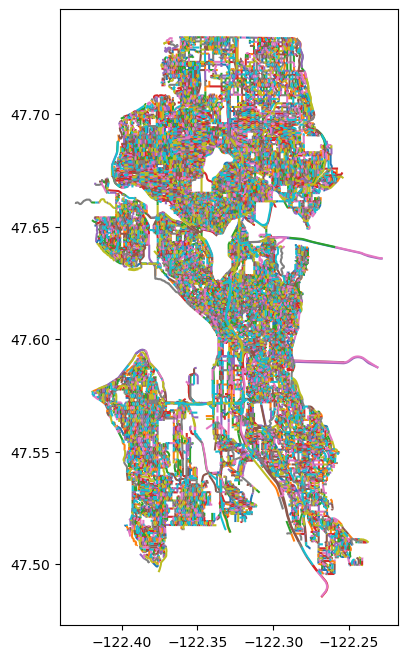

In [7]:
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot('geometry', ax=ax)

In [8]:
import plotly.express as px
import geopandas as gpd
import shapely.geometry
import numpy as np
import wget


In [9]:
gdf['geometry']

0        LINESTRING (-122.33754 47.60612, -122.33820 47...
1        LINESTRING (-122.34001 47.60882, -122.34092 47...
2        LINESTRING (-122.35538 47.62637, -122.35538 47...
3        LINESTRING (-122.35558 47.63912, -122.35557 47...
4        LINESTRING (-122.35553 47.64562, -122.35553 47...
                               ...                        
23836    LINESTRING (-122.34010 47.66573, -122.34009 47...
23837    LINESTRING (-122.28474 47.53888, -122.28409 47...
23838    LINESTRING (-122.32922 47.62688, -122.32923 47...
23839    LINESTRING (-122.28284 47.56619, -122.28177 47...
23840    LINESTRING (-122.38747 47.52247, -122.38807 47...
Name: geometry, Length: 23841, dtype: geometry

In [10]:
lats = []
lons = []
names = []

for feature, name in zip(gdf.geometry, gdf.UNITDESC):
    if isinstance(feature, shapely.geometry.linestring.LineString):
        linestrings = [feature]
    elif isinstance(feature, shapely.geometry.multilinestring.MultiLineString):
        linestrings = feature.geoms
    else:
        continue
    for linestring in linestrings:
        x, y = linestring.xy
        lats = np.append(lats, y)
        lons = np.append(lons, x)
        names = np.append(names, [name]*len(y))
        lats = np.append(lats, None)
        lons = np.append(lons, None)
        names = np.append(names, None)

fig = px.line_geo(lat=lats, lon=lons, hover_name=names)
fig.show()

In [ ]:
len(names)

In [ ]:
px.line_geo(lat=lats, lon=lons)

In [ ]:
lons

In [ ]:
lons[:5]

In [ ]:
fig = px.line_mapbox(lat=lats, lon=lons, hover_name=names,
                     mapbox_style="open-street-map", zoom=10)
fig.show()

In [79]:
list(gdf['geometry'][0].coords)[0][1]

47.60612175846337

In [ ]:
# Want to filter the map to just U-district
# lon (-122.3071, -122.3147) (y coords)
# lat (47.65557, 47.6099)
gdf['geometry'][0].coords

In [81]:
# gdf = gdf.apply(lambda x: np.square(x) if x.name == 'd' else x, axis=1)

longitude_bounds = (-122.3080, -122.3130)
latitude_bounds = (47.65557, 47.6099)
gdf_udistrict = gdf.assign(UDistrict=lambda x: True if (list(x['geometry'].coords)[0][0] >= longitude_bounds[1]) &\
                                      (list(x['geometry'].coords)[0][0] <= longitude_bounds[0]) &\
                                      (list(x['geometry'].coords)[0][1] >= latitude_bounds[1]) &\
                                      (list(x['geometry'].coords)[0][1] <= latitude_bounds[0])
                                    else False, axis=1
                )

AttributeError: 'GeoSeries' object has no attribute 'coords'

In [88]:
names.shape

(211943,)

In [89]:
len(lons)

211943

In [173]:
# gdf = gdf.apply(lambda x: np.square(x) if x.name == 'd' else x, axis=1)

longitude_bounds = (-122.2980, -122.3230)
latitude_bounds = (47.67657, 47.6499)

udist_filter = []
for i in range(len(lons)):
    lon = lons[i]
    lat = lats[i]
    if (lon is None) | (lat is None):
        udist_filter.append(True)        
    elif (lon >= longitude_bounds[1]) & (lon <= longitude_bounds[0]) &\
       (lat >= latitude_bounds[1]) & (lat <= latitude_bounds[0]):
        udist_filter.append(True)
    else:
        udist_filter.append(False)

In [174]:
lons_filt = lons[udist_filter]
lats_filt = lats[udist_filter]
names_filt = names[udist_filter]

In [175]:
fig = px.line_mapbox(lat=lats_filt, lon=lons_filt, hover_name=names_filt,
                     mapbox_style="open-street-map", zoom=12.5, color_discrete_sequence=['#636EFA'])

# fig.update_layout(
#     hoverlabel=dict(
#         bgcolor="white",
#         font_size=16,
#         font_family="Rockwell"
#     )
# )
fig.show()